https://www.tensorflow.org/tutorials/keras/basic_classification

https://github.com/Zackory/Keras-MNIST-GAN/blob/master/mnist_gan.py


In [31]:
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from keras.layers.advanced_activations import LeakyReLU

In [32]:
tr_im = pd.read_csv("resample.csv",index_col=0).values

In [33]:
tr_im.shape

(10050, 4000)

In [34]:
nrow,ncol = 80,50

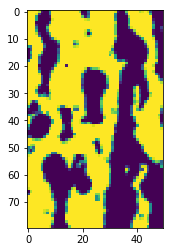

In [35]:
plt.imshow(tr_im[2,:].reshape(nrow,ncol))

In [36]:
npar = 100 #number of standard normal deviates to feed to generator input

In [37]:
tr_im.max()

1.0

In [71]:
#opt = tf.train.AdamOptimizer(learning_rate=0.0005,beta1=0.5)
opt = keras.optimizers.Adam(lr=0.0005,beta_1=0.5)

In [72]:
generator = keras.Sequential()
generator.add(keras.layers.Dense(256, input_dim=npar, kernel_initializer=keras.initializers.RandomNormal(stddev=0.02)))
generator.add(keras.layers.LeakyReLU(0.2))
generator.add(keras.layers.Dense(512))
generator.add(keras.layers.LeakyReLU(0.2))
generator.add(keras.layers.Dense(1024))
generator.add(keras.layers.LeakyReLU(0.2))
generator.add(keras.layers.Dense(nrow*ncol, activation="sigmoid"))
generator.compile(loss='binary_crossentropy', optimizer=opt)
generator.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_68 (Dense)             (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_52 (LeakyReLU)   (None, 256)               0         
_________________________________________________________________
dense_69 (Dense)             (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_53 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
dense_70 (Dense)             (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_54 (LeakyReLU)   (None, 1024)              0         
_________________________________________________________________
dense_71 (Dense)             (None, 4000)              4100000   
Total para

In [73]:
discriminator = keras.Sequential()
discriminator.add(keras.layers.Dense(1024, input_dim=nrow*ncol, kernel_initializer=keras.initializers.RandomNormal(stddev=0.02)))
discriminator.add(keras.layers.LeakyReLU(0.2))
discriminator.add(keras.layers.Dropout(0.3))
discriminator.add(keras.layers.Dense(512))
discriminator.add(keras.layers.LeakyReLU(0.2))
discriminator.add(keras.layers.Dropout(0.3))
discriminator.add(keras.layers.Dense(256))
discriminator.add(keras.layers.LeakyReLU(0.2))
discriminator.add(keras.layers.Dropout(0.3))
discriminator.add(keras.layers.Dense(1, activation='sigmoid'))
discriminator.compile(loss='binary_crossentropy', optimizer=opt)
discriminator.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_72 (Dense)             (None, 1024)              4097024   
_________________________________________________________________
leaky_re_lu_55 (LeakyReLU)   (None, 1024)              0         
_________________________________________________________________
dropout_25 (Dropout)         (None, 1024)              0         
_________________________________________________________________
dense_73 (Dense)             (None, 512)               524800    
_________________________________________________________________
leaky_re_lu_56 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
dropout_26 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_74 (Dense)             (None, 256)               131328    
__________

In [74]:
discriminator.trainable = False
gi = keras.layers.Input(shape=(npar,))
x = generator(gi)
go = discriminator(x)
gan = keras.Model(inputs=gi,outputs=go)
gan.compile(loss="binary_crossentropy",optimizer=opt)

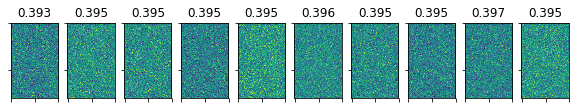

In [75]:

def plot_gen():
    fig, axes = plt.subplots(nrows=1,ncols=10,figsize = (10,10))
    plot_noise = np.random.randn(10,npar) 
    vecs = generator.predict(plot_noise)#.reshape(10,28,28)
    isreal = discriminator.predict(vecs)
    #print(isreal.shape)
    for ax,vec,real in zip(axes.flatten(),vecs.reshape(10,nrow,ncol),isreal.flatten()):
        ax.imshow(vec)
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_title("{0:1.3G}".format(real))
plot_gen()
#generator.save("test.h5")
o_d = "gen_models"
if os.path.exists(o_d):
    shutil.rmtree(o_d)

39


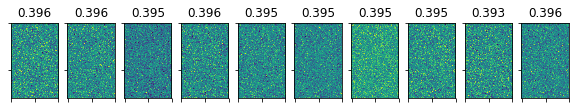

1 0.6933887 0.46285987


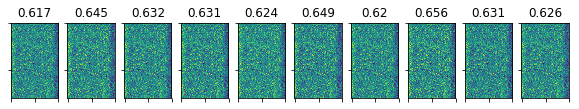

2 0.68773717 0.60780424


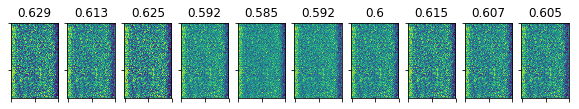

3 0.6688071 0.85358256


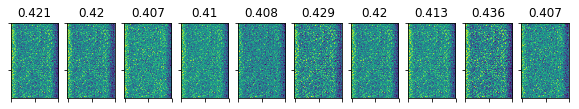

4 0.7015122 0.74790174


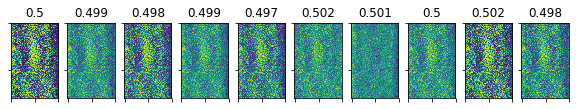

5 0.6426941 0.75762475


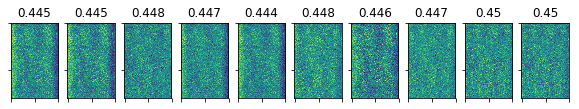

6 0.72752404 0.687289


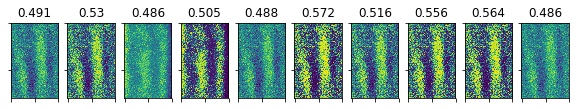

7 0.67337334 0.8018956


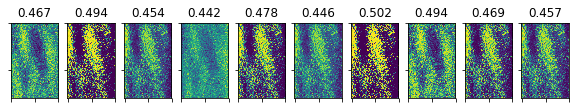

8 0.6779344 0.7029219


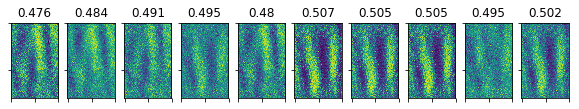

9 0.6259902 0.9368951


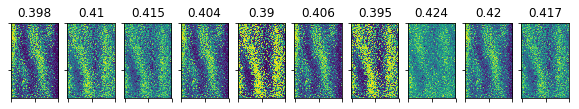

10 0.62949 0.73402154


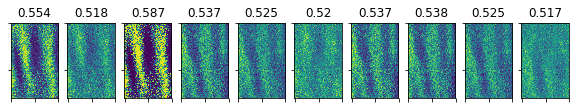

11 0.6920259 0.9012983


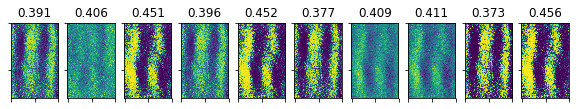

12 0.6676874 0.7918388


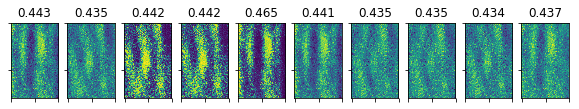

13 0.6059269 0.77408457


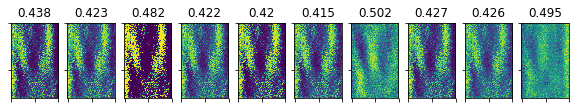

14 1.008859 0.9983022


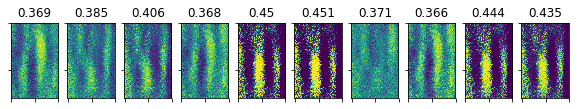

15 0.72422504 0.5903319


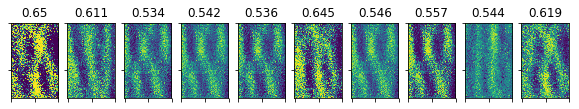

16 0.66235083 0.4855199


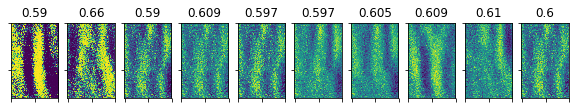

17 0.7252363 1.6721189


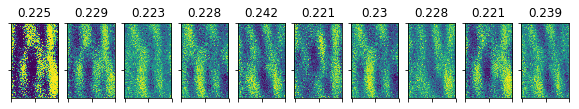

18 0.65163946 0.75872576


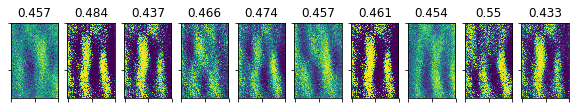

19 0.6799575 0.6748168


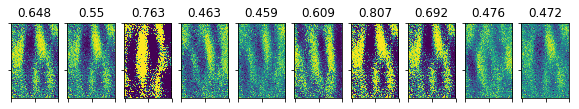

20 0.6503608 0.960748


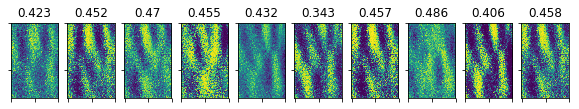

21 0.6180692 0.90394354


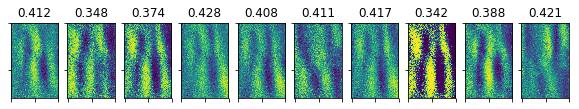

22 0.737609 0.7739601


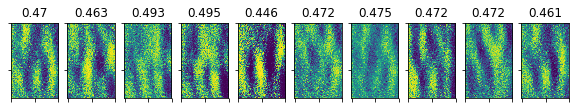

23 0.6913935 0.6057661


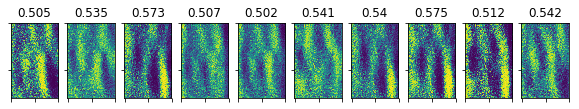

24 0.7238893 0.7207736


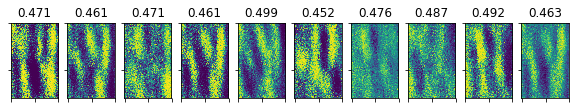

25 0.6196014 0.28553006


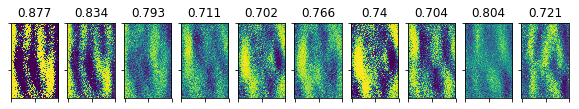

26 0.68688595 0.67718977


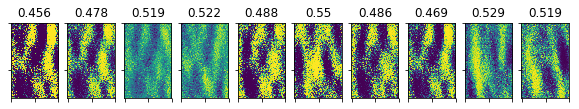

27 0.6183426 0.74361306


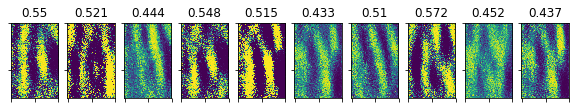

28 0.62377465 1.1580033


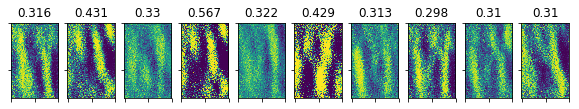

29 0.66323113 1.1215223


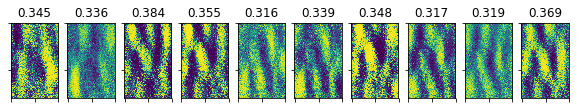

30 0.648994 0.8041862


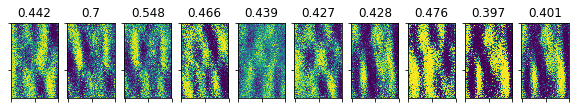

31 0.6484649 1.449089


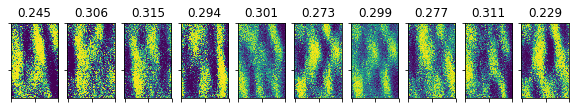

32 0.6144068 0.8526826


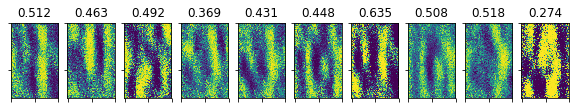

33 0.880839 0.8227839


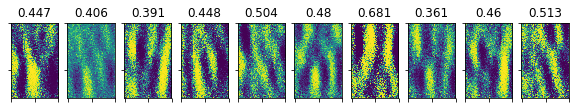

34 0.59947526 1.3077853


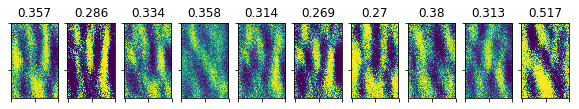

35 0.6336221 0.8851898


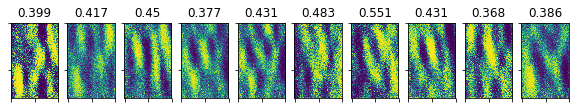

36 0.6506237 0.7563312


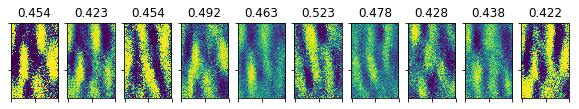

37 0.58142585 1.912965


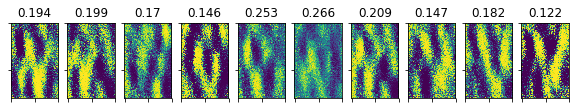

38 0.56219816 1.1839103


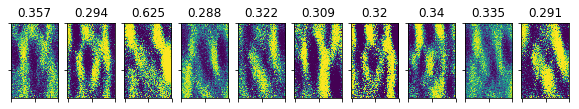

39 0.6078323 0.8587249


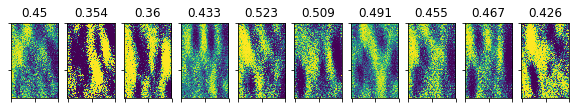

40 0.5655906 0.8713503


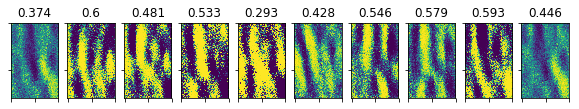

41 0.6200603 0.831941


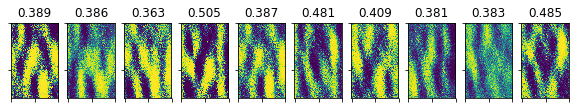

42 0.56111276 1.5447457


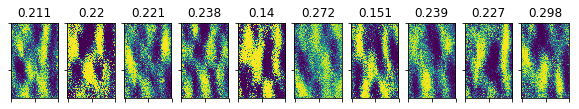

43 0.5682448 1.0153114


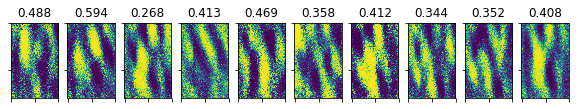

44 0.5733642 1.305587


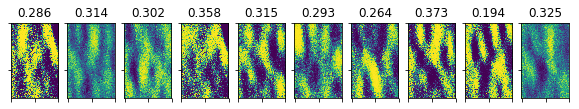

45 0.7029107 1.0991387


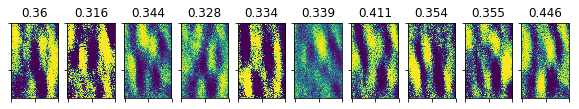

46 0.57199 0.89569557


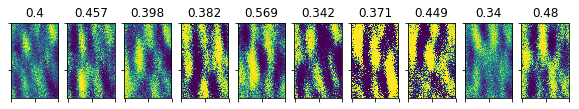

47 0.64112294 0.7951665


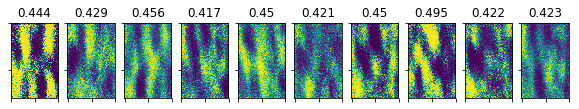

48 0.6356579 0.90697396


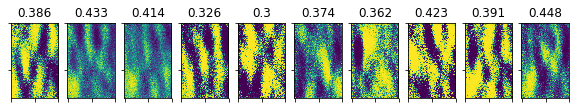

49 0.5776173 0.9082689


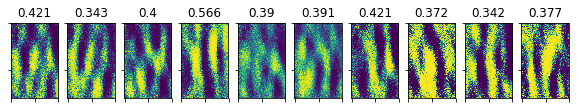

50 0.5871861 1.7803617


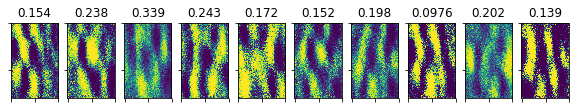

51 0.58939123 0.9459396


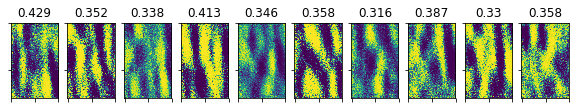

52 0.7398857 0.956181


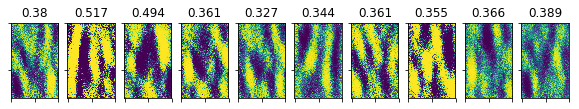

53 0.6074346 0.97971904


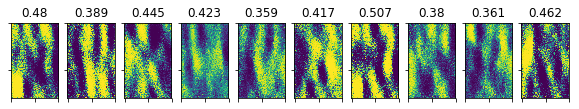

54 0.6355318 0.7927036


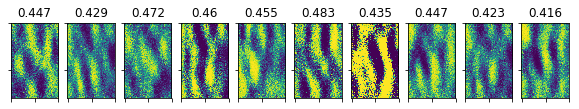

55 0.64564365 1.0984098


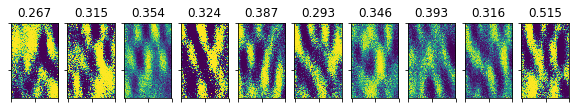

56 0.6796993 0.7847731


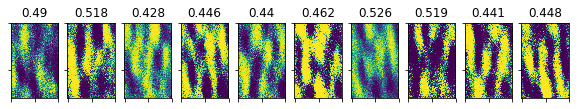

57 0.5451493 1.0682716


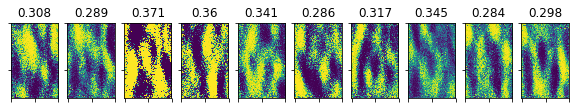

58 0.6760677 0.8159218


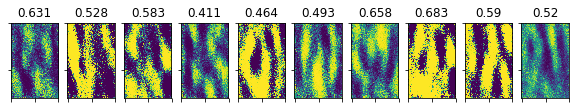

59 0.5675808 0.85641026


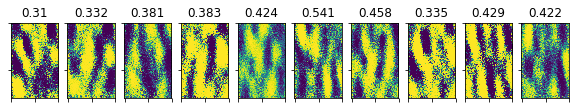

60 0.59811413 0.77130127


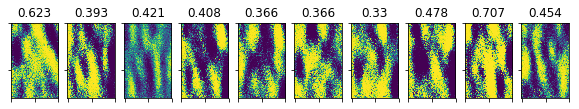

61 0.7472093 1.0218288


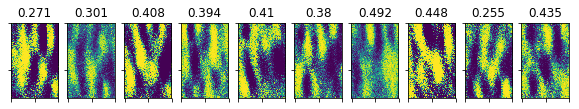

62 0.65177405 0.7377458


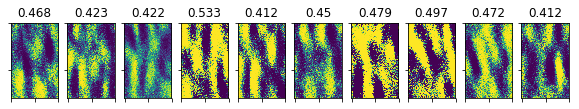

63 0.601108 0.5931339


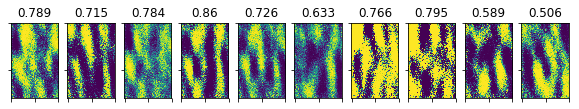

64 0.5689317 0.9391493


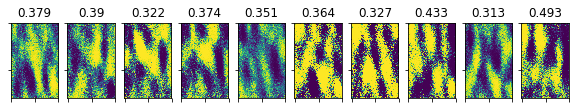

65 0.60483897 1.3518572


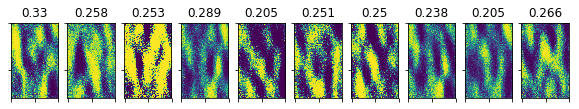

66 0.6103931 0.8707968


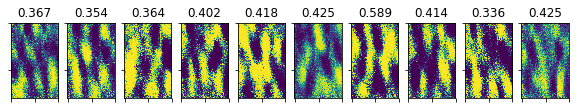

67 0.6020919 0.7888253


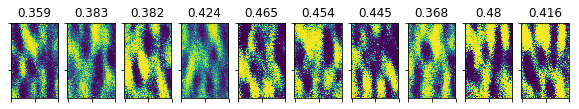

68 0.7075773 2.131341


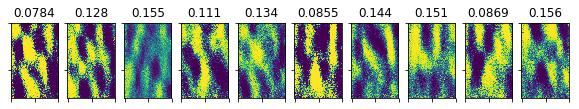

69 0.5963793 1.2877636


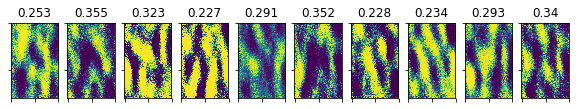

70 0.5984528 0.8122595


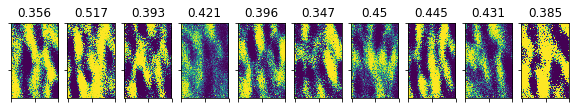

71 0.5492841 0.987721


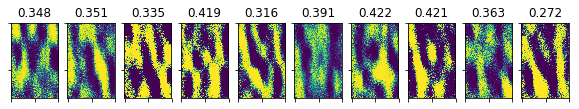

72 0.6572381 0.6505537


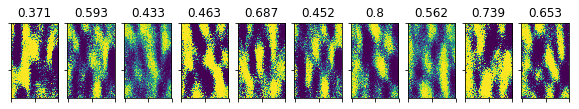

73 0.65032 0.7258028


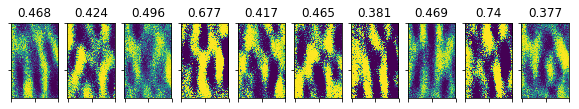

74 0.5824059 0.9340942


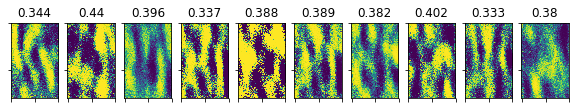

75 0.5321988 0.99484384


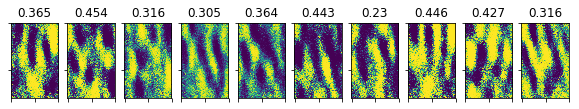

76 0.707942 0.44157797


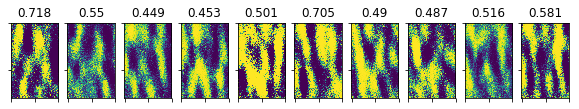

77 0.57008266 0.8499651


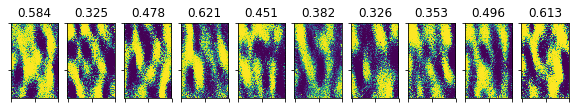

78 0.6552979 1.8289931


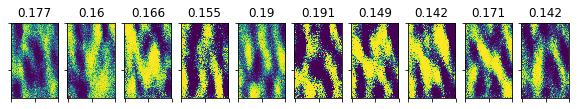

79 0.5512537 0.95399004


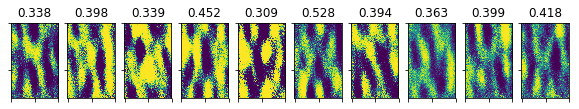

80 0.57887286 0.71675575


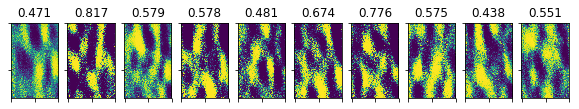

81 0.57216513 0.9395543


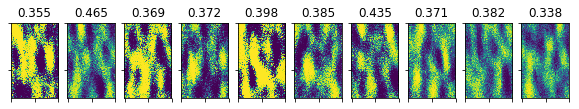

82 0.5550724 1.0999439


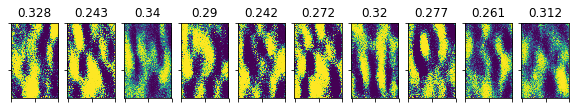

83 0.64769393 0.7224374


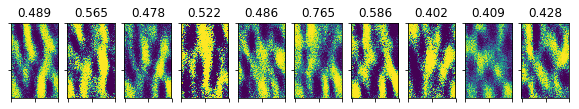

84 0.5962862 1.2417116


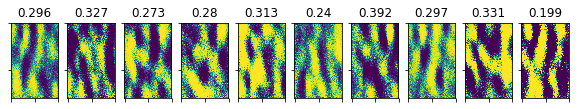

85 0.63184685 1.0642524


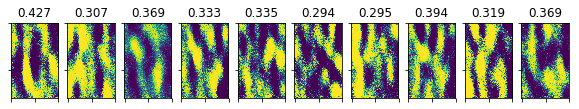

86 0.5664451 0.93928504


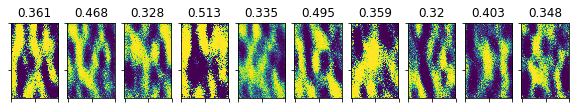

87 0.5652541 0.97763276


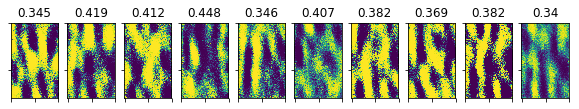

88 0.5212376 0.88663816


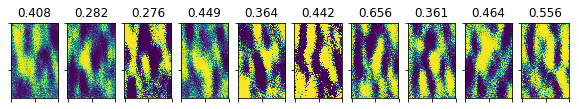

89 0.6258534 0.7982009


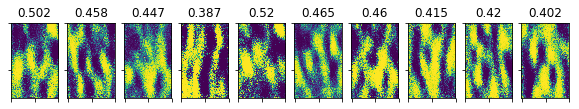

90 0.5519163 0.91251504


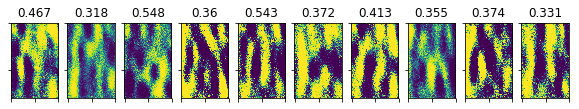

91 0.5569221 0.82359827


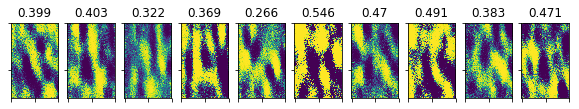

92 0.69493616 1.4692943


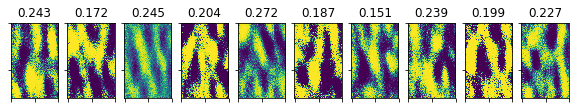

93 0.55859005 1.13335


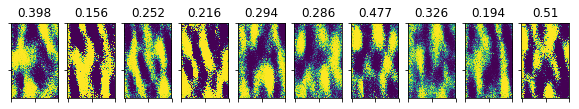

94 0.55148125 0.94470847


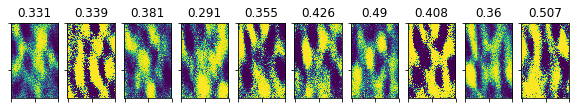

95 0.531724 1.2341704


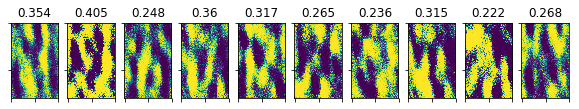

96 0.7112866 0.60456914


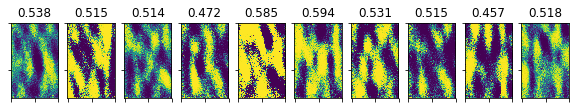

97 0.57419443 1.3203803


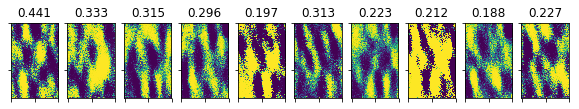

98 0.5685091 1.5497175


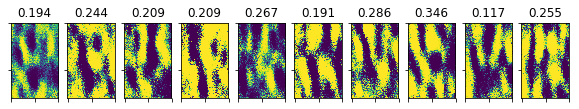

99 0.4872712 1.2393875


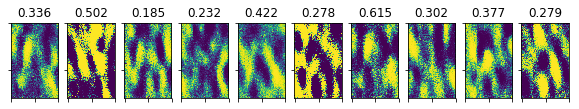

100 0.5801157 1.1253091


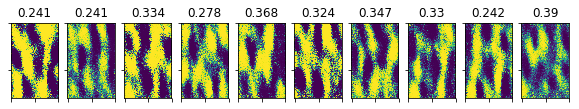

101 0.63340956 1.2464342


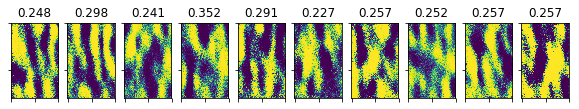

102 0.56465936 0.96509683


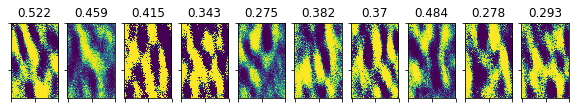

103 0.5499869 1.0261273


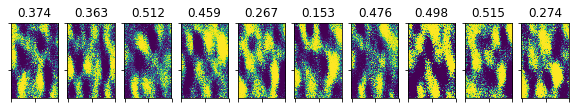

104 0.67551726 0.6671876


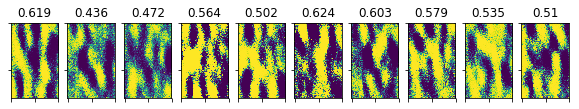

105 0.5678791 1.0894952


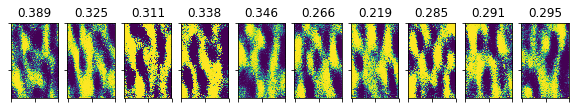

106 0.58203995 0.987482


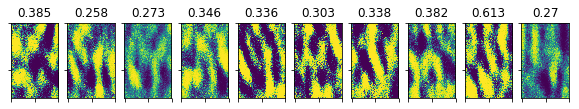

107 0.5917684 0.9337481


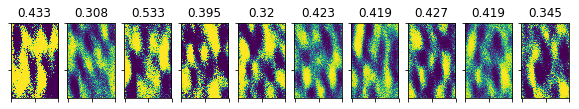

108 0.58053684 1.4218587


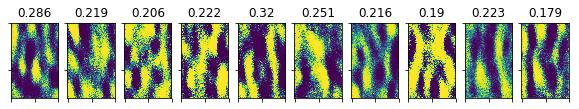

109 0.52498853 0.9863653


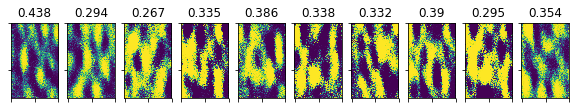

110 0.5555233 1.2483944


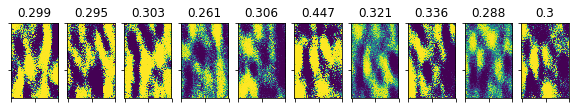

111 0.6105852 1.1500477


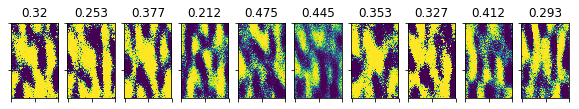

112 0.5706153 1.0591056


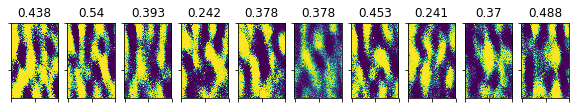

113 0.5553461 1.1462275


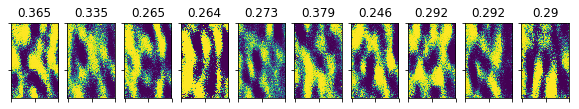

114 0.49327186 1.0489423


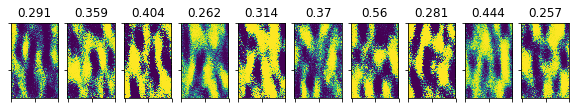

115 0.6496414 0.736426


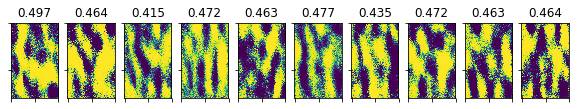

116 0.5909284 1.0700431


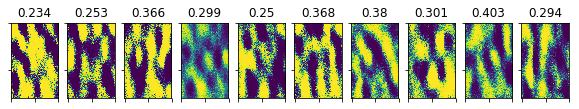

117 0.5599633 1.2756164


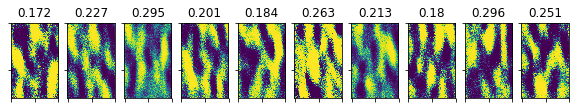

118 0.6064626 0.68990314


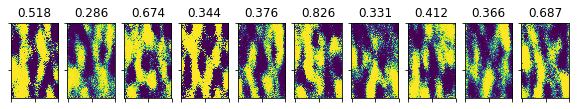

119 0.54157716 1.0787408


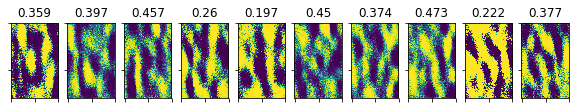

120 0.5722023 0.7253416


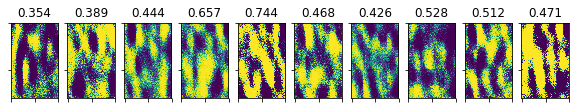

121 0.53909296 1.0374072


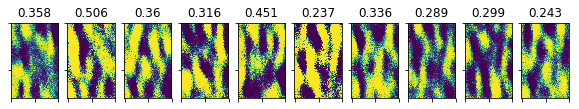

122 0.53965616 0.95543265


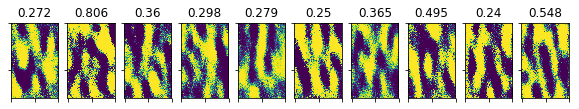

123 0.5623673 1.4977627


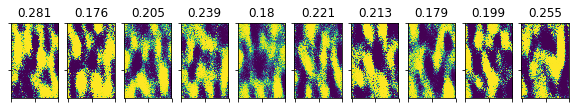

124 0.56564397 0.9458232


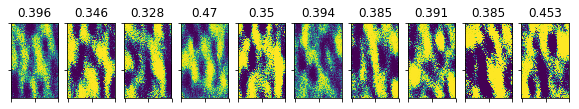

125 0.5765418 0.95330024


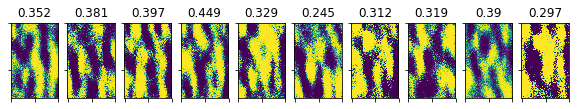

126 0.58697784 0.67616963


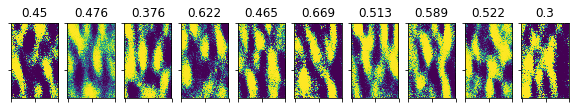

127 0.7409771 2.6175208


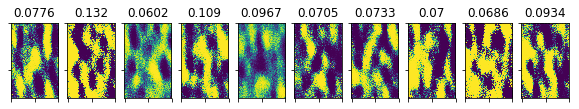

128 0.5362753 1.0625485


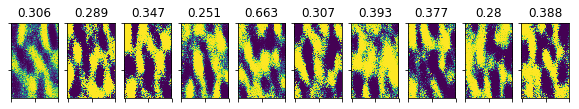

129 0.5822578 1.0375483


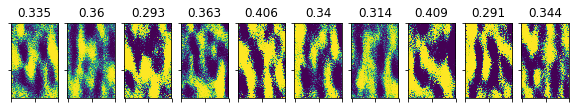

130 0.5868348 0.53742146


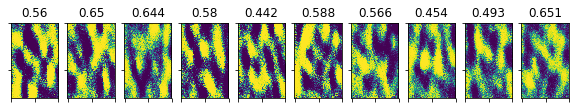

131 0.6468916 0.74362195


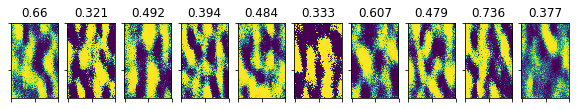

132 0.7819106 0.66857725


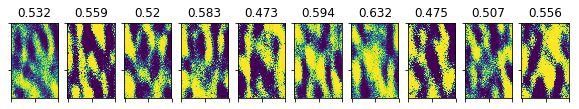

133 0.54995817 1.5006862


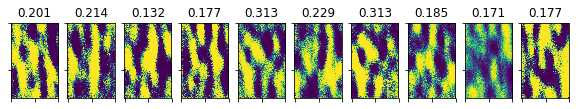

134 0.56928843 0.99644953


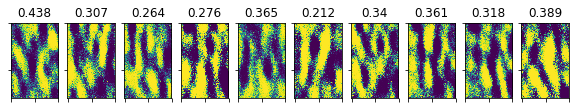

135 0.52356744 1.19718


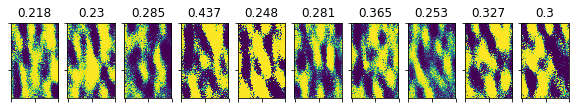

136 0.5425412 1.4075619


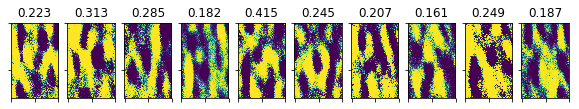

137 0.55932295 0.90601957


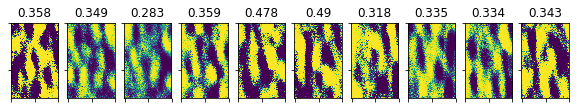

138 0.95170647 1.1382797


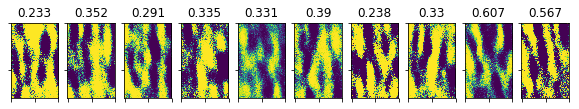

139 0.5598419 1.0796881


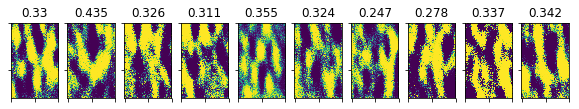

140 0.66448784 0.6212666


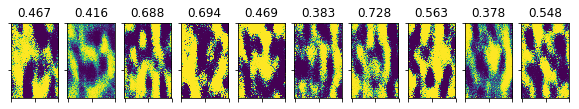

141 0.6742686 0.8837446


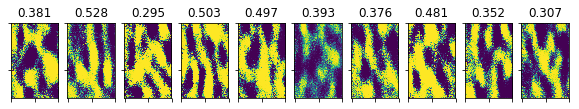

142 0.55504704 1.3473039


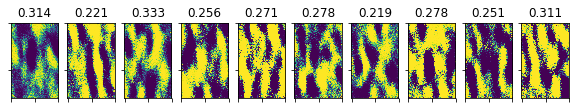

143 0.52853644 1.2911707


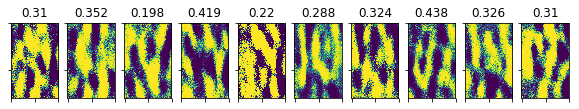

144 0.5859227 1.6909943


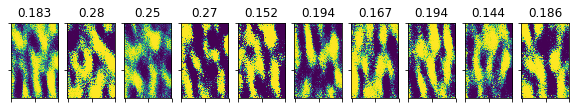

145 0.6225076 0.5348916


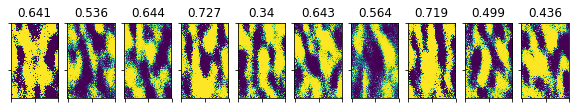

146 0.5864107 1.0852426


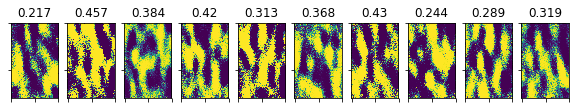

147 0.53861326 0.85880184


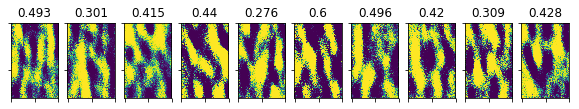

148 0.6382631 0.9477936


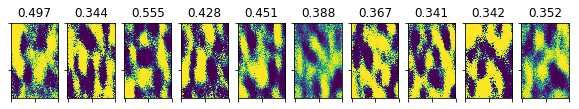

149 0.50272167 1.1546693


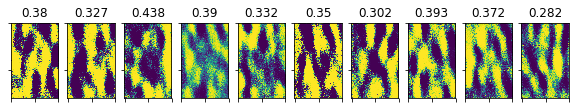

150 0.5435691 1.0229328


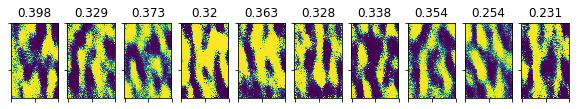

151 0.56754655 1.2743793


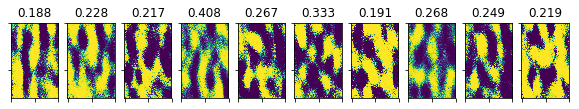

152 0.5348594 0.62431544


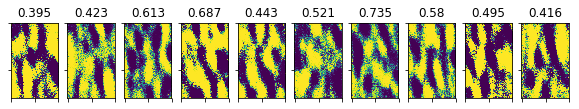

153 0.63034075 0.86226904


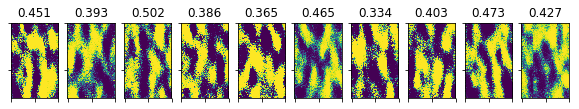

154 0.5550581 0.93735826


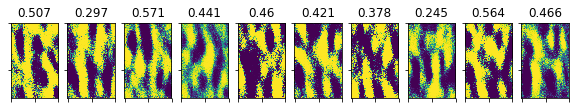

155 0.53214705 1.1071081


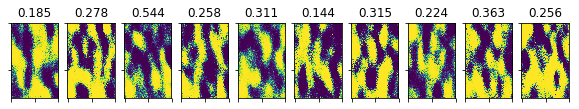

156 0.5883466 1.511159


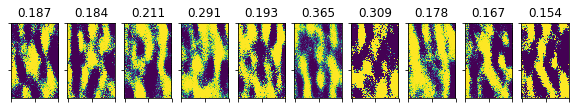

157 0.6682623 0.95911795


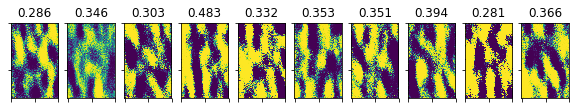

158 0.5749204 1.9829853


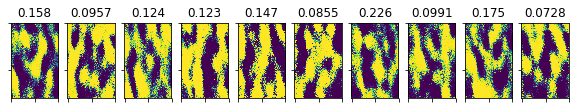

159 0.54032254 0.9966321


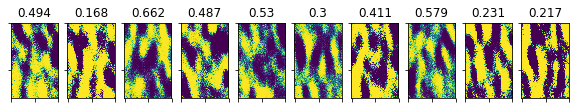

160 0.5635986 1.364011


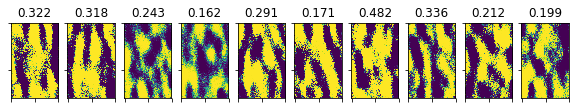

161 0.61936325 0.871979


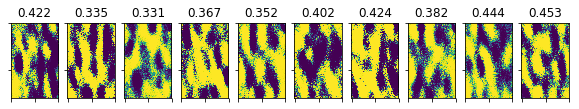

162 0.5950655 1.58984


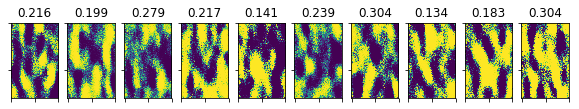

163 0.5474038 0.5564814


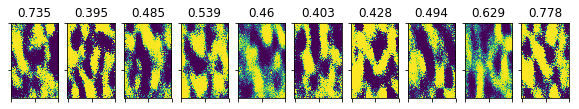

164 0.57622486 0.99367833


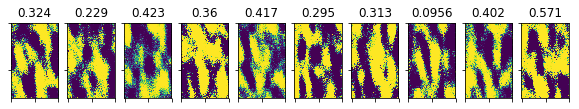

165 0.57097536 1.5476598


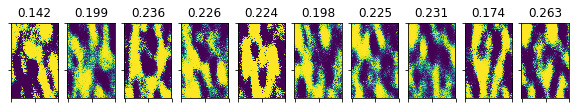

166 0.5655652 1.166126


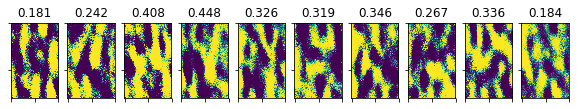

167 0.5556797 0.9866615


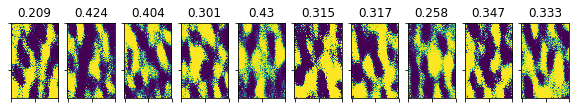

168 0.77990186 0.48930988


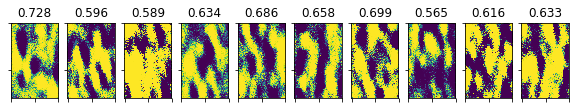

169 0.5694661 1.0451028


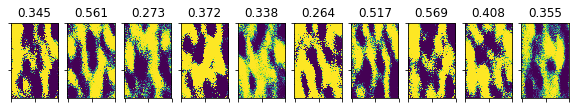

170 0.53527904 0.98663366


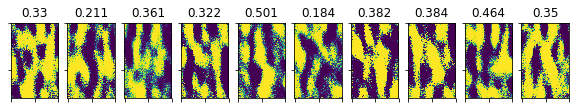

171 0.62618595 0.82999736


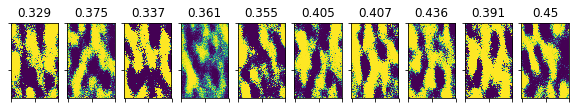

172 0.55056584 1.1312828


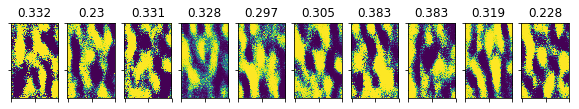

173 0.5573751 1.1570048


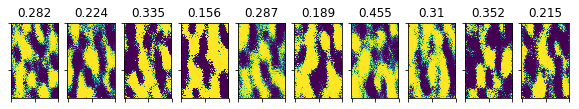

174 0.568869 1.049307


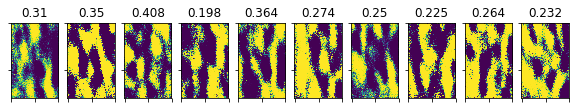

175 0.5607137 1.3507807


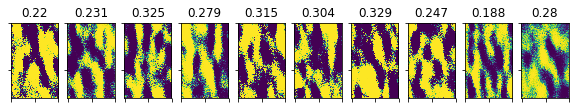

176 0.56656945 1.7883466


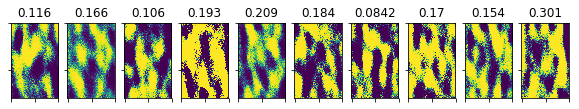

177 0.5567229 0.96411794


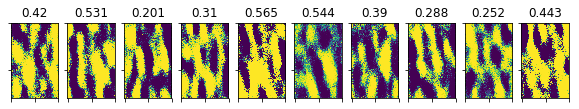

178 0.5483048 0.7598125


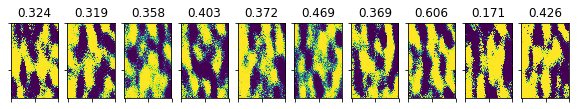

179 0.5950955 1.4863873


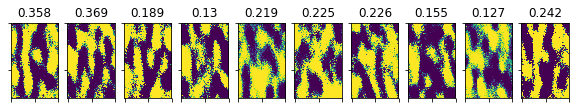

180 0.54811835 1.22914


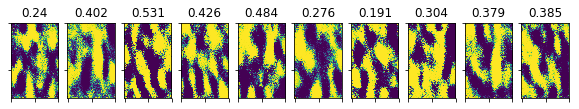

181 0.56607556 1.4332044


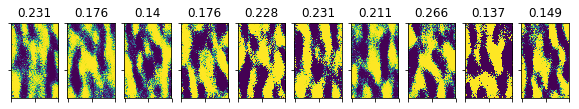

182 0.5178562 0.98125756


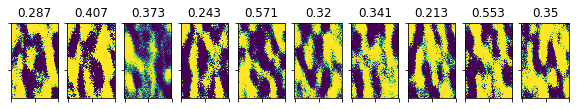

183 0.526669 1.0856985


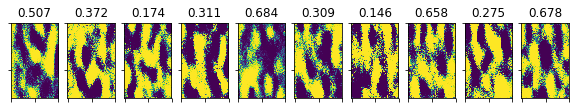

184 0.5968685 1.6643173


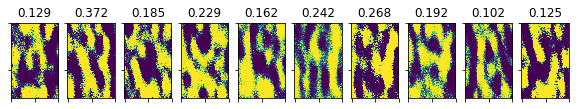

185 0.51457006 1.1664244


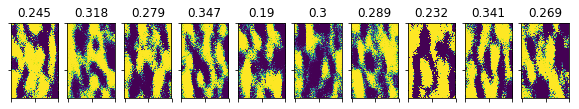

186 1.230205 1.479387


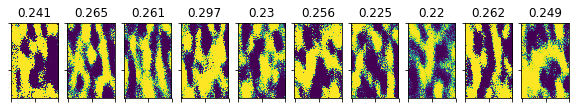

187 0.5424058 1.0314109


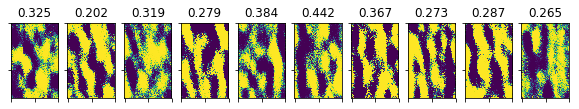

188 0.5323386 1.0675919


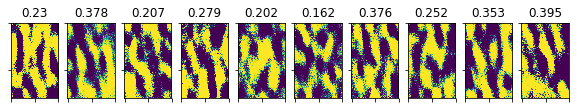

189 0.5366527 1.596216


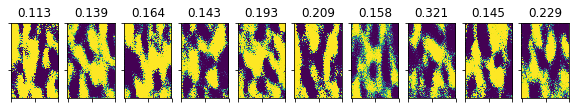

190 0.5194557 1.137187


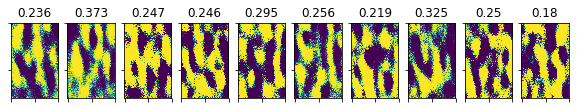

191 0.5442953 1.2082256


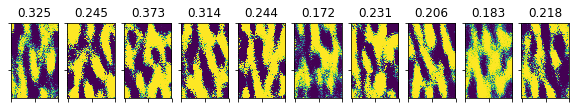

192 0.5443075 1.1404879


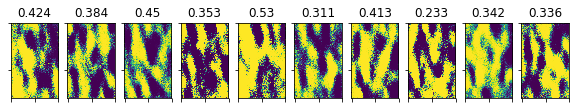

193 0.59253764 0.74683094


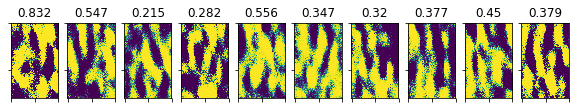

194 0.77764916 2.359213


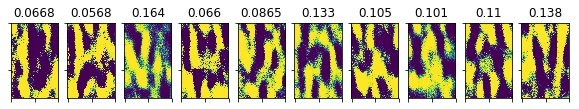

195 0.68319035 0.7180253


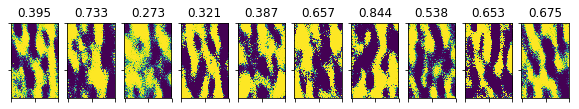

196 0.54808545 1.0161854


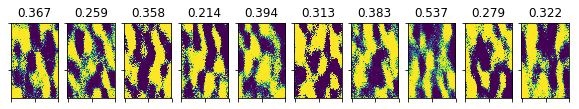

197 0.52917814 1.2676194


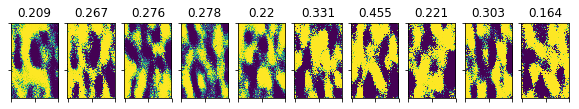

198 0.53318167 1.1883085


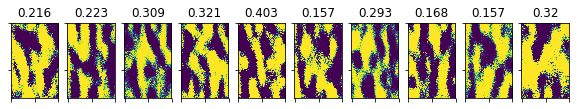

199 0.5184378 1.20923


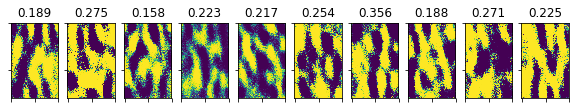

200 0.64045656 1.0197333


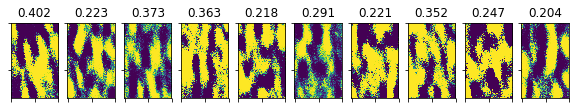

201 0.5782064 1.6282054


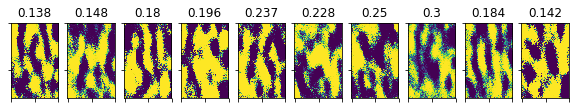

202 1.0263976 1.0988395


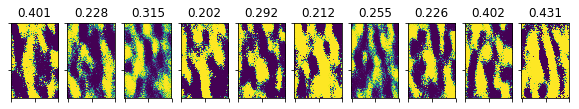

203 0.5168317 1.3424846


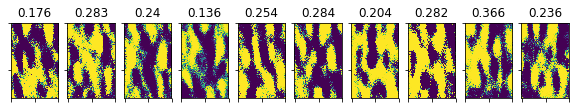

204 0.511977 1.3696945


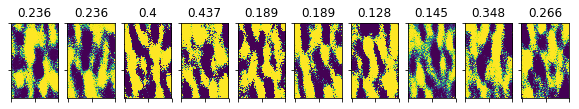

205 0.54066616 1.2528644


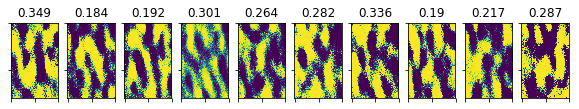

206 0.57254 0.9263568


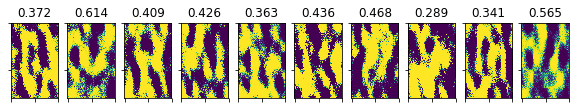

207 0.56358784 1.1300864


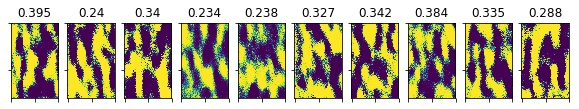

208 0.5584446 0.9715048


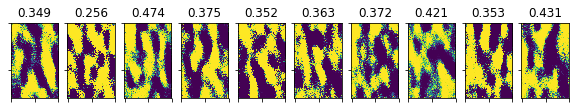

209 0.5249283 1.548305


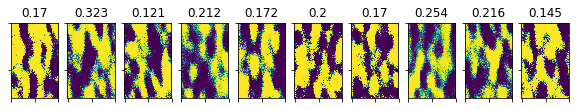

210 0.5526681 1.3161358


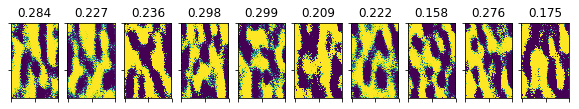

211 0.59486026 0.52331716


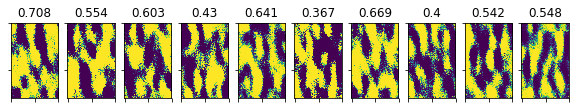

212 0.53318274 1.0510777


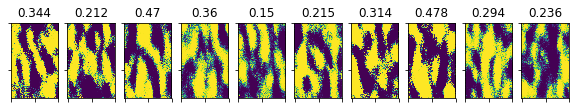

213 0.48723394 1.1647494


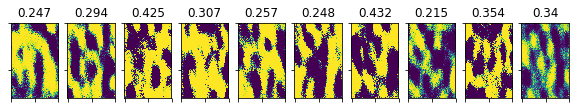

214 0.69298863 0.95642596


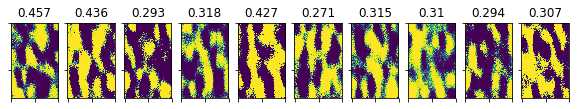

215 0.51267636 0.9990265


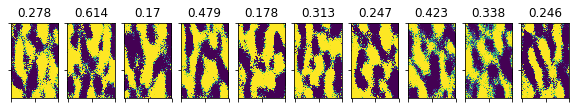

216 0.50754005 1.2313342


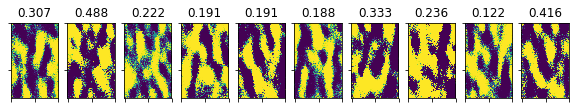

217 0.58244777 1.8771518


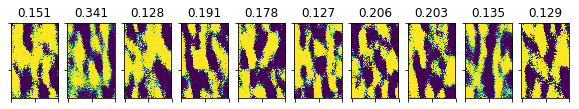

218 0.50605094 1.4047718


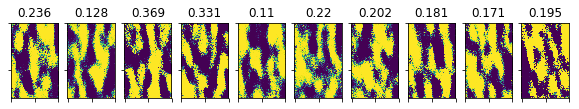

219 0.4796343 1.4797187


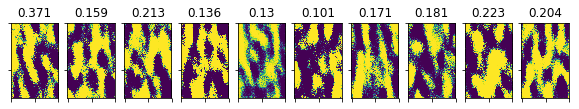

220 0.4987593 1.5644745


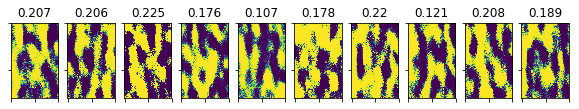

221 0.48387757 1.4653642


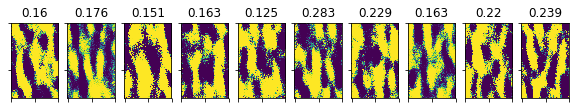

222 0.5365181 0.97038305


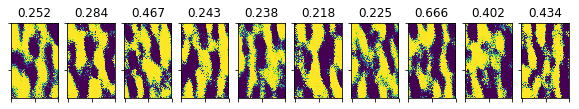

223 0.50455374 1.091304


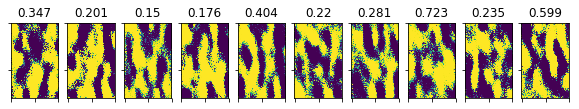

224 0.5226338 1.1203358


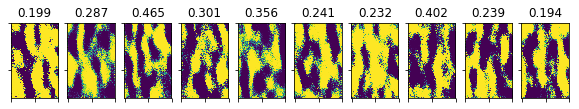

225 0.5344951 1.092323


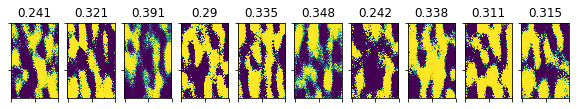

226 0.54477686 1.3433509


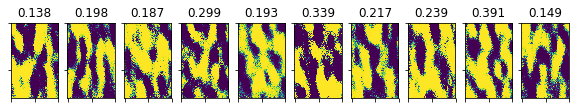

227 0.53613806 1.1669261


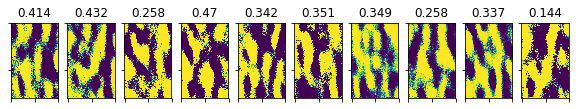

228 0.5193799 1.2285986


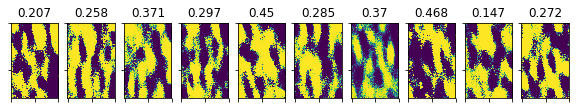

229 0.54786205 1.0535948


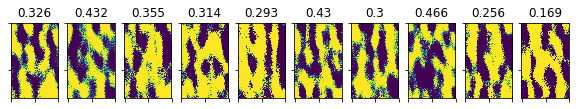

230 0.55471814 1.1142725


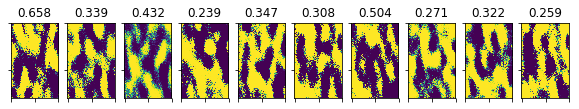

231 0.55866915 1.4304168


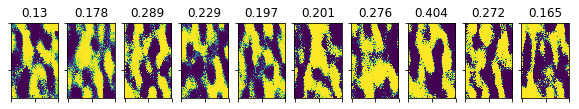

232 0.54277015 1.1061349


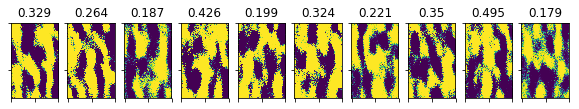

233 0.5129361 1.379564


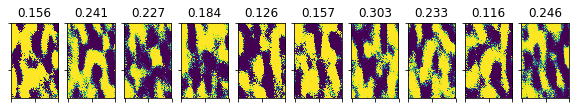

234 0.54209375 1.5261427


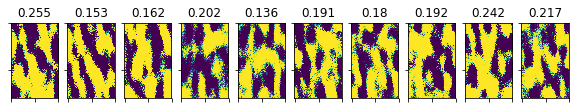

235 0.6163886 2.2221847


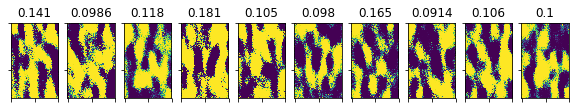

236 0.5672231 0.88368535


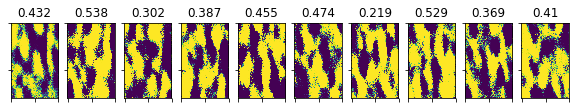

237 0.5516615 0.7913996


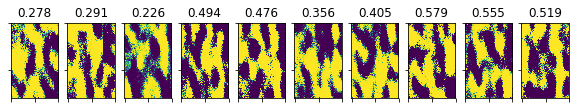

238 0.56491804 1.8067975


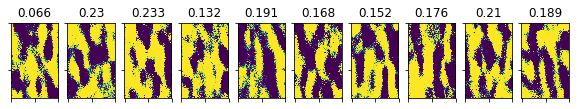

239 0.5229763 1.1784487


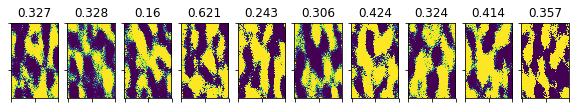

240 0.5583618 0.9798141


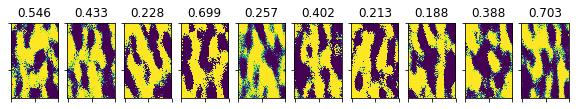

241 0.61199707 0.7174078


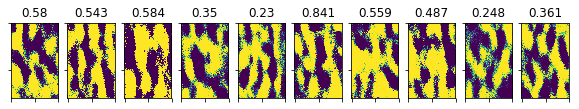

242 0.5341027 1.3075775


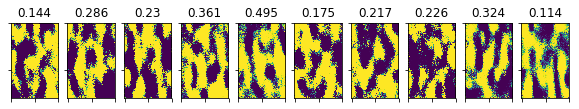

243 0.54347026 0.96691394


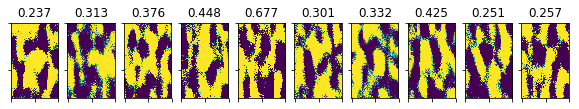

244 0.5030657 1.6897128


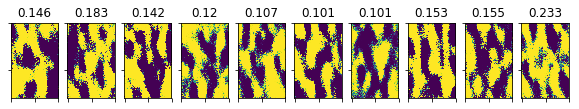

245 0.5115099 1.2705789


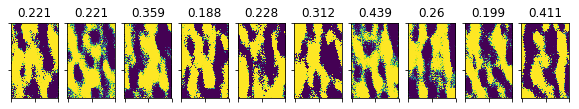

246 0.52304196 1.4444289


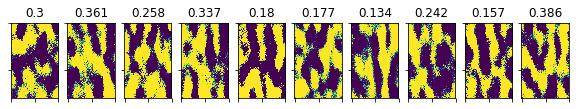

247 0.7253904 1.5698149


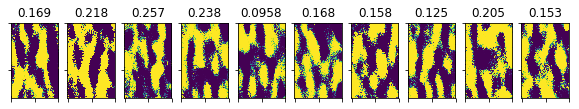

248 0.5069023 1.4803967


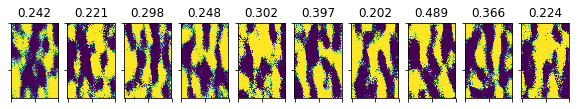

249 0.51270807 1.1695085


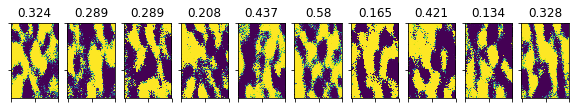

250 0.51959735 1.4424307


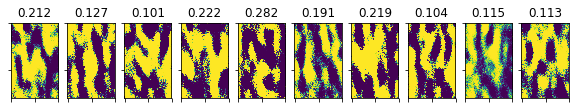

251 0.60226357 0.9892134


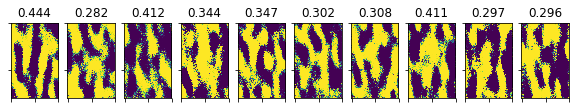

252 0.5591545 1.2023118


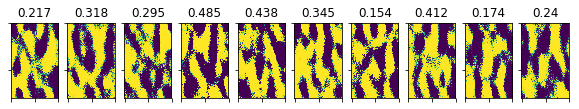

253 0.49524376 1.0543418


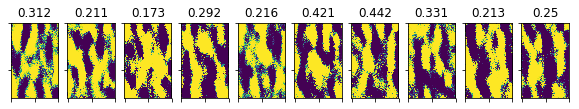

254 0.5018275 1.5088246


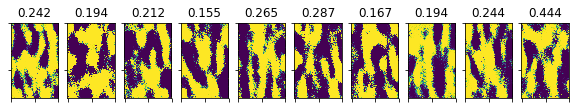

255 0.48762158 1.5819428


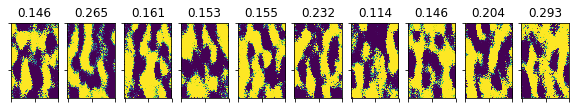

256 0.5383373 0.82390696


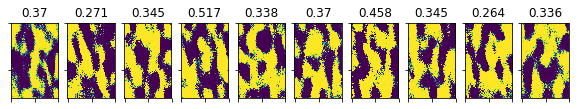

257 0.48927334 1.5180591


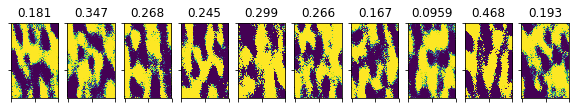

258 0.68948984 1.0563587


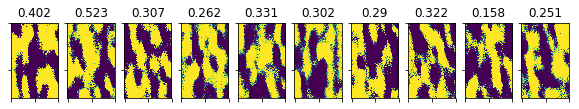

259 0.54435265 1.1887755


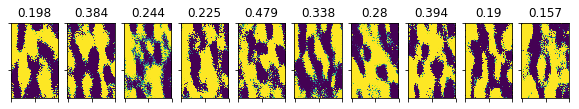

260 0.5093405 1.9809623


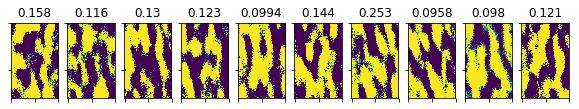

261 0.5580877 1.1286659


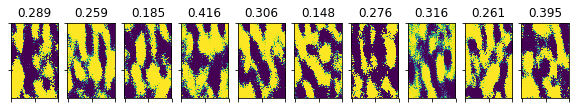

262 0.50145155 0.99065584


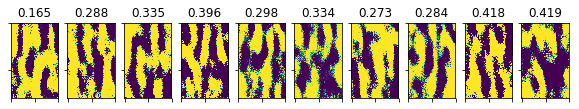

263 0.51682734 1.1465719


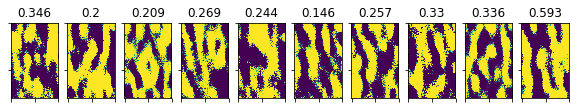

264 0.53950125 1.0555532


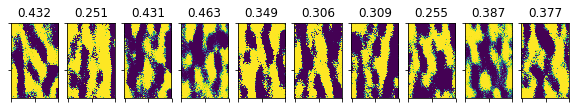

265 0.50894475 1.6382446


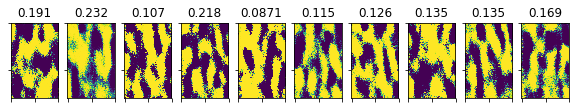

266 0.50805104 0.9019928


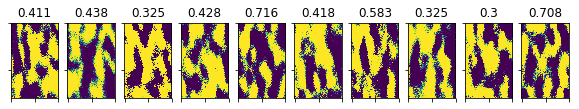

267 0.490239 1.0518309


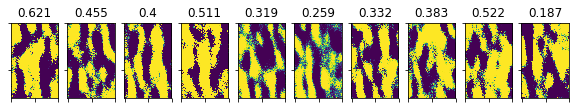

268 0.5124996 1.2739081


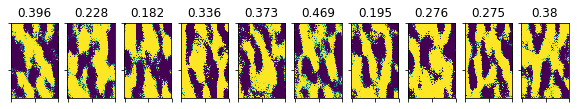

269 0.5117403 1.177593


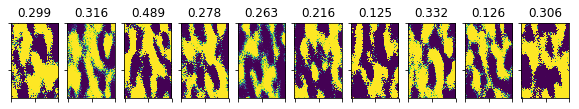

270 0.49150693 1.0877444


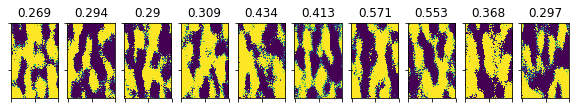

271 0.5365175 1.6406865


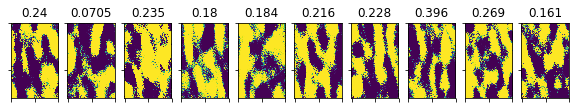

272 0.63721997 0.9427775


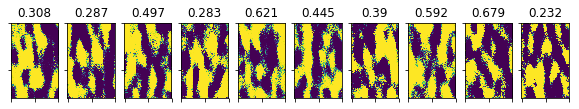

273 0.63395166 1.5917976


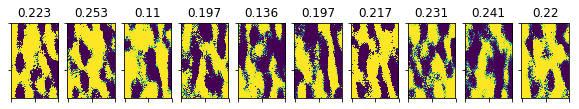

274 0.5263892 1.0761045


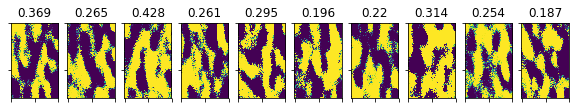

275 0.5610439 2.3372722


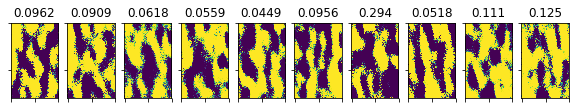

276 0.50678885 1.0986259


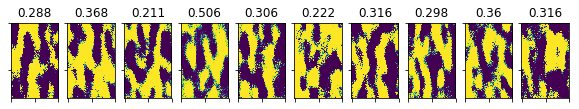

277 0.54467916 1.7665899


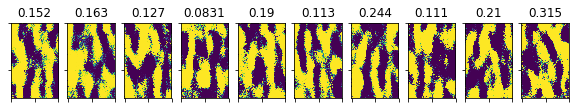

278 0.50247306 1.0345366


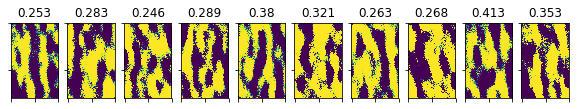

279 0.51059365 1.380348


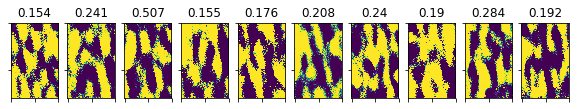

280 0.52885604 1.8218277


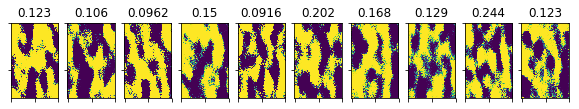

281 0.5683626 1.5167286


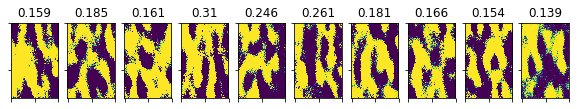

282 0.5326704 1.317682


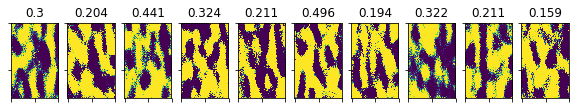

283 0.5418451 1.1918945


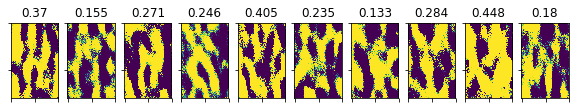

284 0.5347889 1.1216307


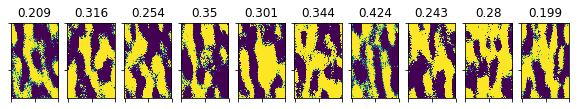

285 0.515215 1.1782693


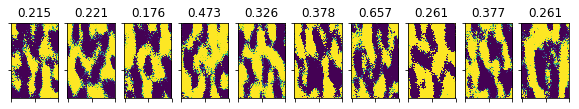

286 0.53278697 1.1836815


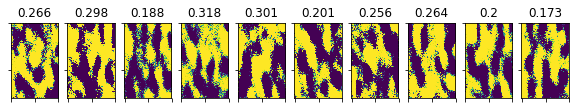

287 0.83756834 1.2301763


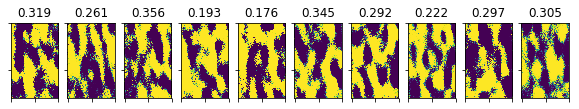

288 0.56394595 1.086704


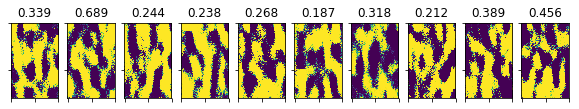

289 0.5614333 1.9558662


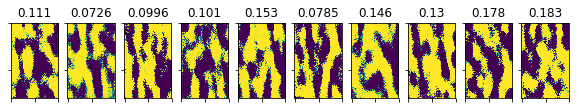

290 0.544703 1.2284241


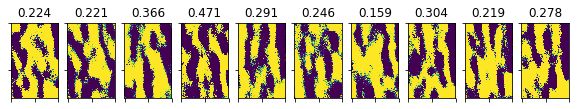

291 0.5013807 1.1732277


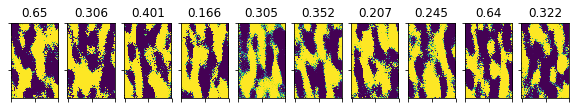

292 0.48283306 1.2388014


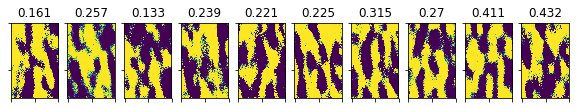

293 0.52960134 2.25629


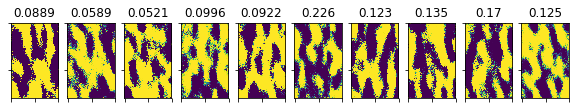

294 0.5329983 1.3828198


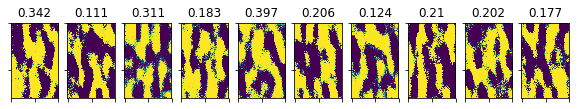

295 0.5179635 1.4861732


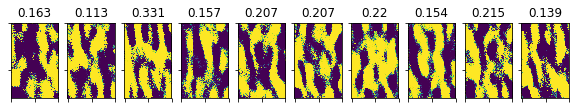

296 0.5109756 1.5623357


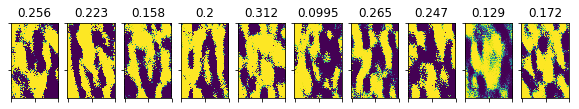

297 0.53565097 1.1071904


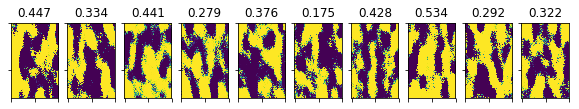

298 0.5633019 1.7592484


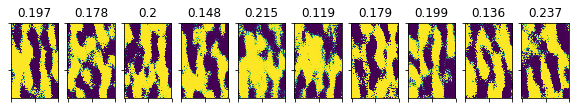

299 0.5235958 1.1325268


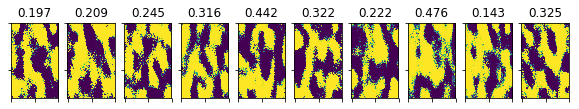

300 0.5447904 1.5591547


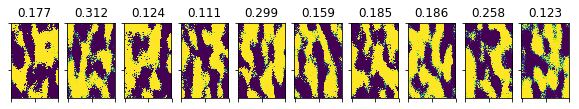

301 0.5330608 1.7501569


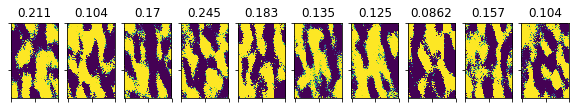

302 0.51874083 1.7464349


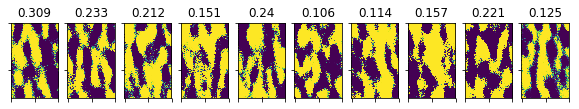

303 0.56302345 0.8293736


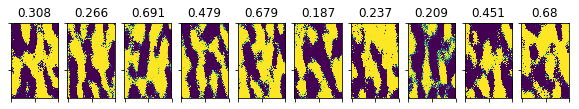

304 0.51858294 1.9540095


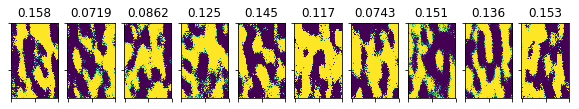

305 0.49970633 1.5085903


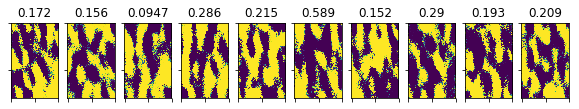

306 0.54601586 1.2344282


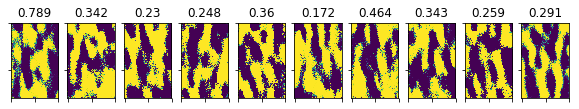

307 0.54145336 2.0297246


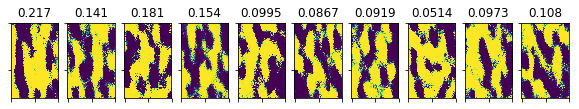

308 0.5046204 1.1263909


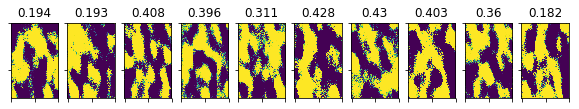

309 0.5027382 1.014627


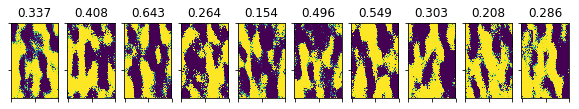

310 0.53087157 1.118827


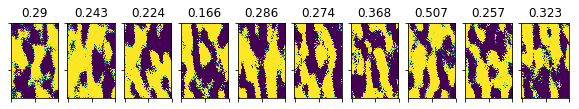

311 0.59190917 1.7555916


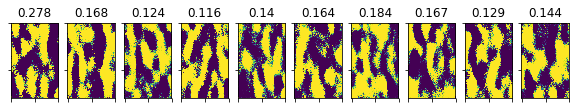

312 0.51093405 1.3610773


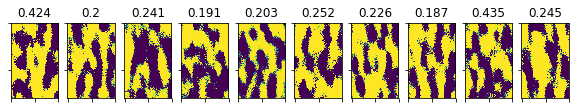

313 0.5272065 1.4236094


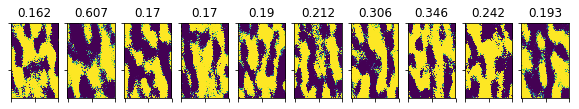

314 0.50848264 1.5910413


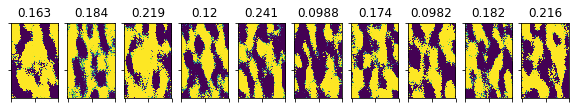

315 0.48296493 1.3023252


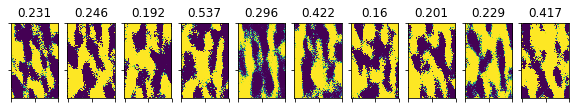

316 0.4813288 1.2956212


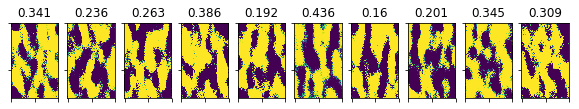

317 0.48041883 1.229914


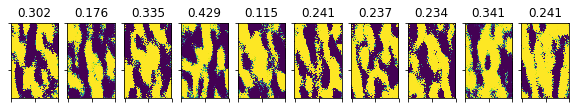

318 0.5325259 1.541745


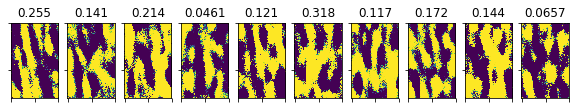

319 0.5061495 1.290205


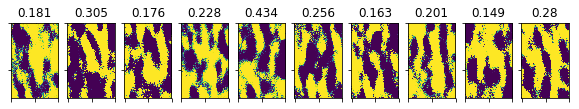

320 0.81994563 1.0604088


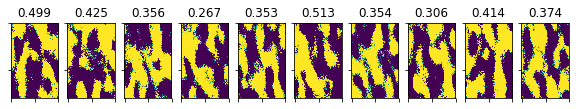

321 0.5306025 1.2823242


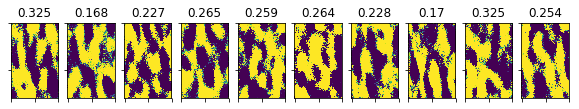

322 0.50086224 1.2473954


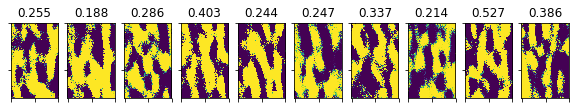

323 0.53734183 1.7993219


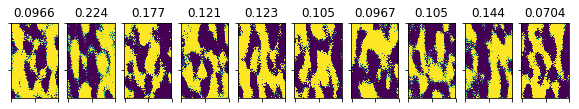

324 0.519535 1.1893263


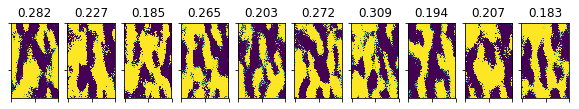

325 0.59423476 1.1043935


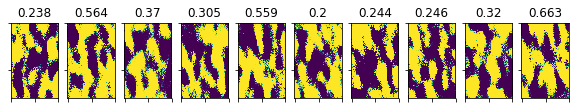

326 0.51609755 1.201214


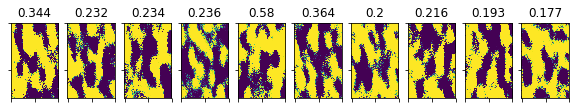

327 0.52447045 1.2591357


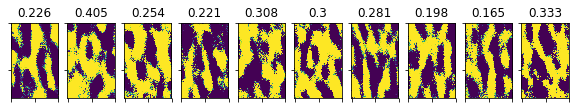

328 0.5933408 0.71172965


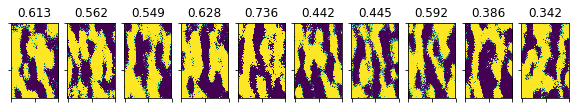

329 0.49660304 1.1986692


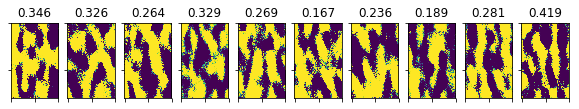

330 0.49868047 1.1390266


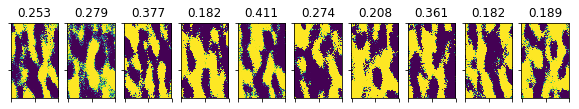

331 0.4930472 1.6302443


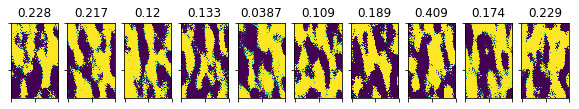

332 0.5462252 1.1423253


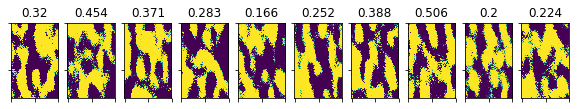

333 0.5063578 1.4215988


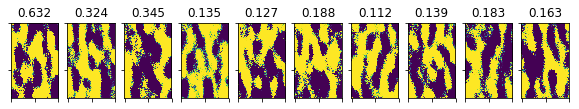

334 0.49877262 1.41594


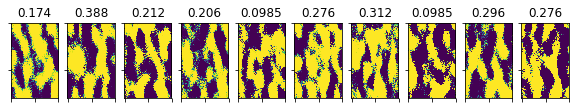

335 0.5194351 1.3086562


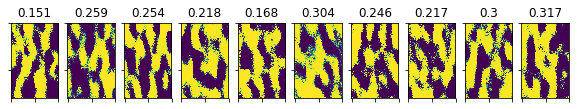

336 0.47578323 1.3987589


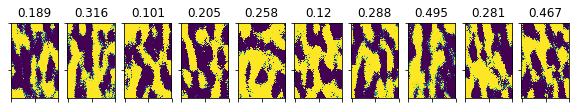

337 0.544013 1.153326


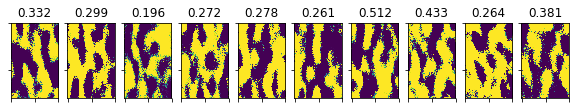

338 0.53666925 0.8823229


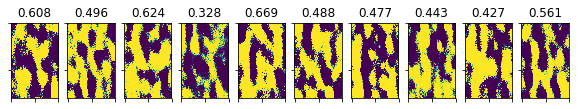

339 0.510744 1.3626001


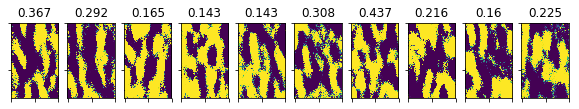

340 0.5151576 1.2101892


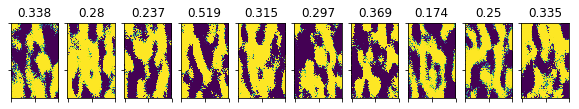

341 0.50313187 1.5414325


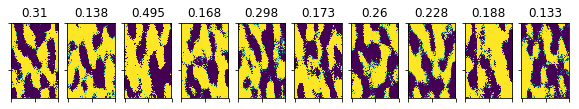

342 0.51693034 1.4898559


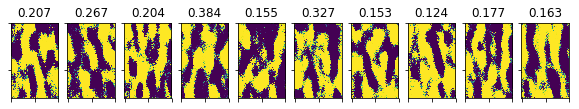

343 0.5495796 1.2678057


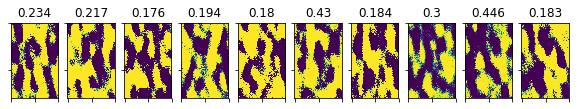

344 0.5173705 1.5800177


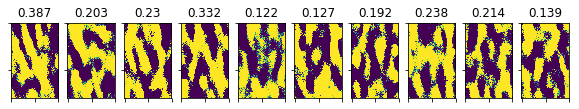

345 0.5013184 1.2813649


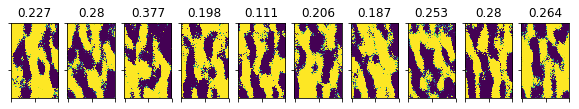

346 0.49852067 1.2027174


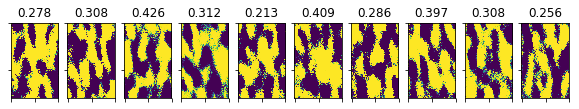

347 0.4822251 1.3974986


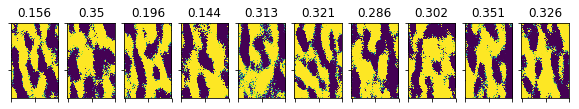

348 0.5237107 1.94942


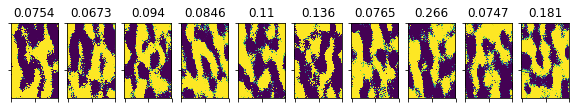

349 0.5202414 1.0845457


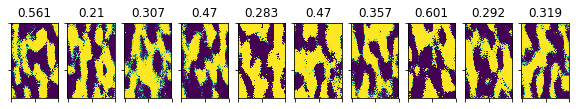

350 0.56437397 0.9230766


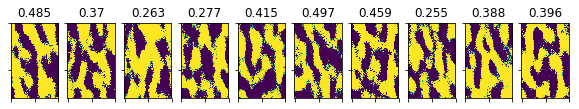

351 0.5927725 0.8780839


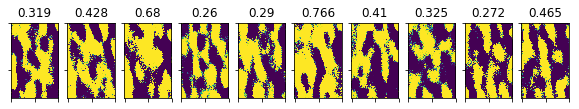

352 0.6409501 1.106346


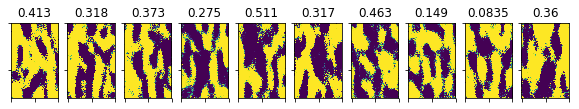

353 0.5295588 1.2320588


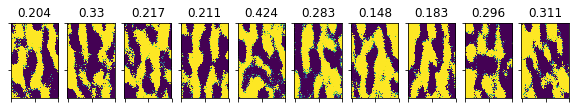

354 0.60758066 0.5548788


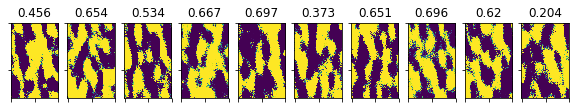

355 0.53729624 1.751553


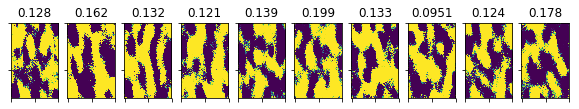

356 0.5287819 1.4107444


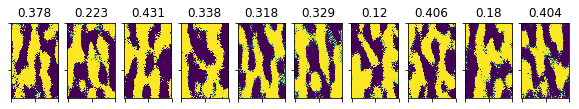

357 0.5339258 1.3809553


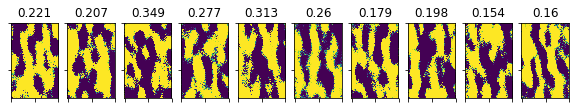

358 0.55636287 1.1483798


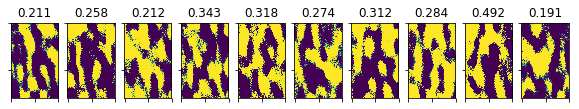

359 0.57551706 2.1036425


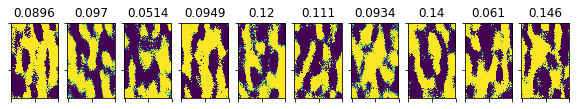

360 0.49829674 1.4784527


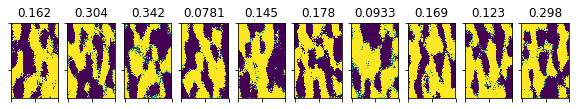

361 0.5172044 1.797202


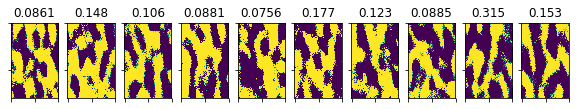

362 0.54860497 1.3086107


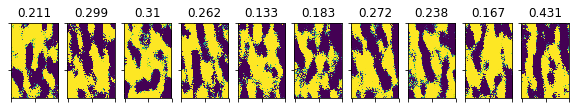

363 0.5387342 1.778598


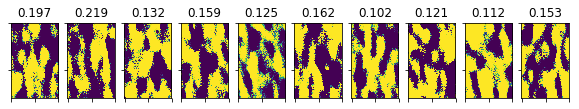

364 0.55099475 1.4758188


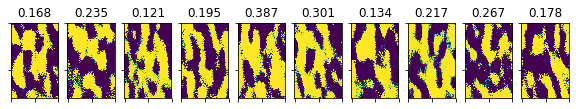

365 0.5009278 1.5331342


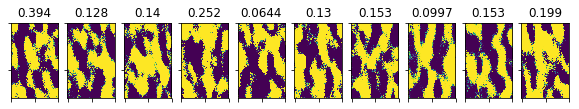

366 0.5341606 1.147886


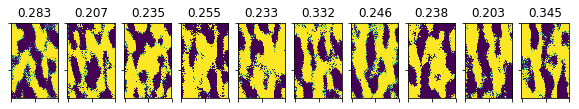

367 0.4963181 1.1460552


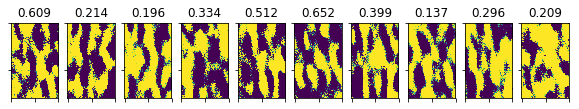

368 0.53095835 1.2427919


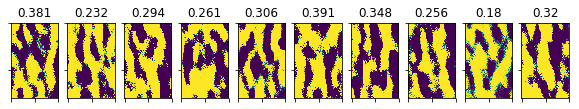

369 0.5499004 1.2523731


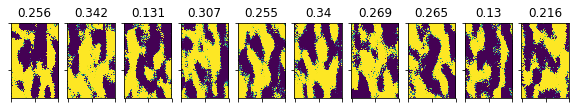

370 0.50191534 1.1138282


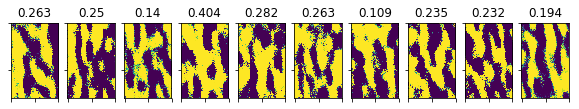

371 0.51515985 1.430217


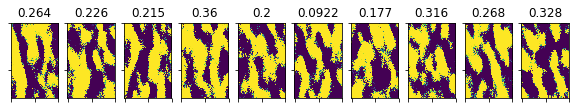

372 0.5230275 1.7157669


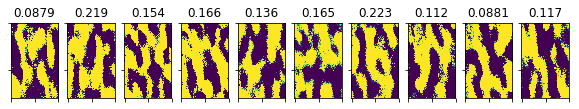

373 0.5105184 1.3272849


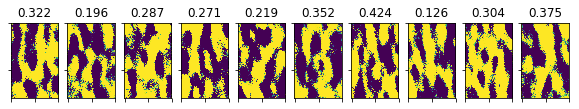

374 0.5858319 1.008329


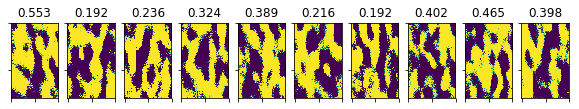

375 0.51255584 1.6457589


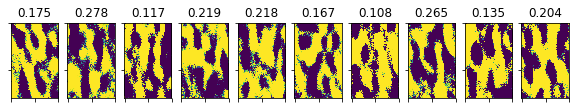

376 0.51370966 1.2172761


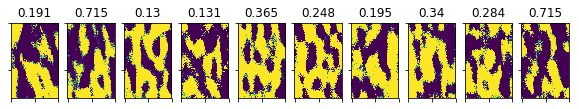

377 0.5271655 1.2940891


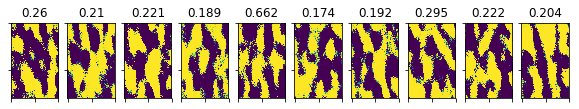

378 0.49783474 1.5022796


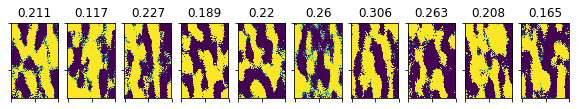

379 0.5172607 1.1278154


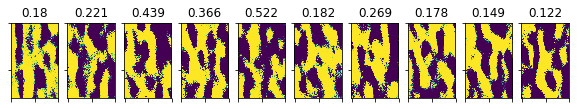

380 0.48738962 1.3840168


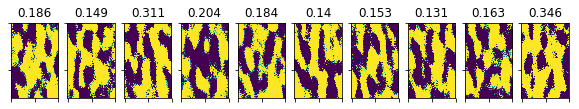

381 0.62032175 1.0017099


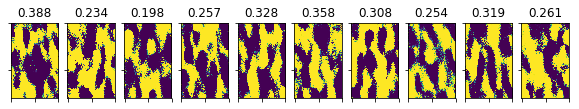

382 0.48571017 1.1406947


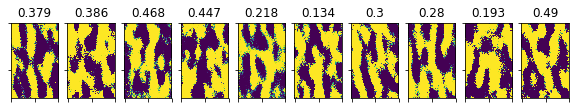

383 0.5543442 1.053189


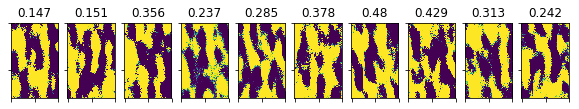

384 0.53243625 1.5721354


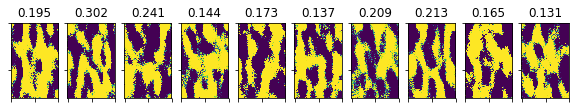

385 0.47175083 1.294197


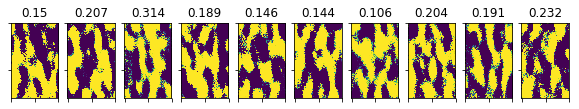

386 0.49978378 1.3277802


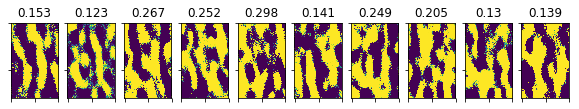

387 0.49615073 1.3699352


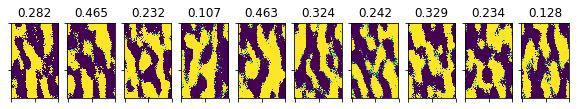

388 0.4994587 1.7872941


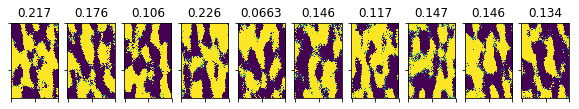

389 0.5839317 1.1051369


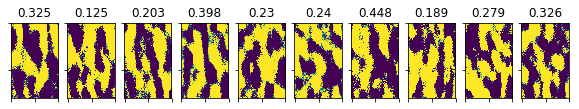

390 0.49868745 1.4578838


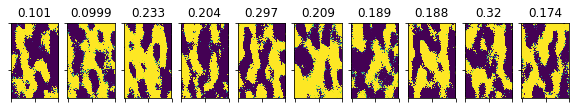

391 0.49890974 0.9568238


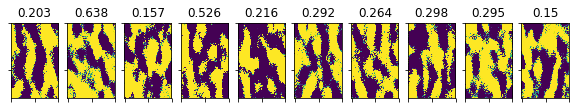

392 0.50376153 1.3330402


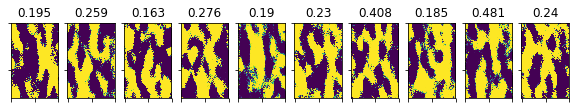

393 0.558856 1.5088967


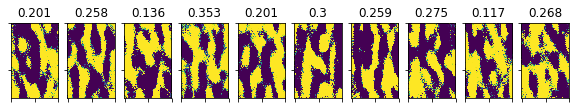

394 0.5296 1.4950844


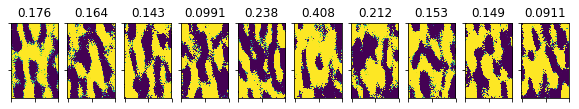

395 0.5801097 1.1239727


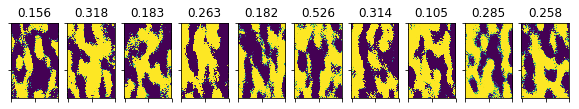

396 0.50946915 1.2413481


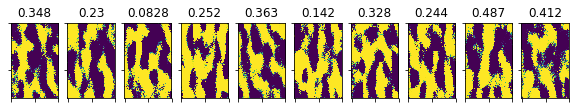

397 0.5381303 1.2892177


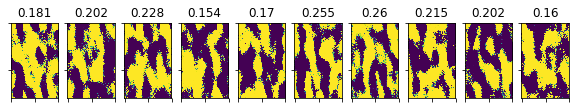

398 0.59803224 0.9697936


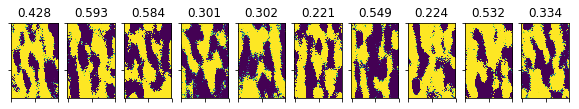

399 0.5027677 1.4225988


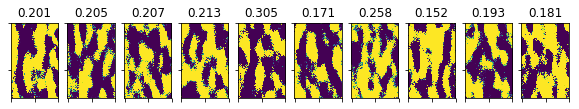

In [76]:
batch_size = 256
batch_count = int(tr_im.shape[0] / batch_size)
print(batch_count)
plot_gen()
plt.show()
for e in range(1,400):
    for _ in range(batch_count):
        noise = np.random.randn(batch_size,npar)
        tr_im_batch = tr_im[np.random.randint(0,tr_im.shape[0],size=batch_size)]
        gen_im = generator.predict(noise)
        #print(gen_im.shape,tr_im_batch.shape)
        tr_im_batch = np.concatenate([tr_im_batch,gen_im])
        #noisy labels...
        tr_im_lab = np.zeros(tr_im_batch.shape[0])
        tr_im_lab[:batch_size] = np.random.uniform(0.9,1.0,size=batch_size)
        tr_im_lab[batch_size:] = np.random.uniform(0.0,0.1,size=batch_size)
        discriminator.trainable = True
        dloss = discriminator.train_on_batch(tr_im_batch,tr_im_lab)
        noise = np.random.randn(batch_size,npar)
        tr_img_lab = np.ones(batch_size)
        discriminator.trainable = False
        gloss = gan.train_on_batch(noise,tr_img_lab)
    
    if e % 1 == 0:
        print(e,dloss,gloss)
        plot_gen()
        plt.show()
        #generator.save(os.path.join(o_d,"gen_{0}.h5").format(e))
        
    

In [77]:
generator.save("gen.h5")